In [1]:
# core
import sys
import time

# custom
sys.path.append('../code/poloniex')
sys.path.append('../code')
import polo_eda as pe
import calc_TA_sigs as cts
import data_processing as dp

# installed
import pandas as pd
import numpy as np
import statsmodels.api as sm

# plotting
import plotly
plotly.offline.init_notebook_mode()
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Scatter, Figure, Layout, Candlestick
from plotly.tools import FigureFactory as FF
import plotly.graph_objs as go
import matplotlib.pyplot as plt
%matplotlib inline

/usr/local/lib/python3.5/dist-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [2]:
df = pe.read_trade_hist('BTC_STR')

In [3]:
# resamples to the hour
rs_full = dp.resample_ohlc(df, resamp='H')

In [4]:
rs_full = dp.make_mva_features(rs_full)

In [5]:
bars = cts.create_tas(bars=rs_full, verbose=True)

using multiplier of 1000000


In [13]:
indicators = ['bband_u_cl', # bollinger bands
             'bband_m_cl',
             'bband_l_cl',
             'bband_u_tp',
             'bband_m_tp',
             'bband_l_tp',
             'bband_u_cl_diff',
             'bband_m_cl_diff',
             'bband_l_cl_diff',
             'bband_u_cl_diff_hi',
             'bband_l_cl_diff_lo',
             'bband_u_tp_diff',
             'bband_m_tp_diff',
             'bband_l_tp_diff',
             'bband_u_tp_diff_hi',
             'bband_l_tp_diff_lo',
             'dema_cl',
             'dema_tp',
             'dema_cl_diff',
             'dema_tp_diff',
             'ema_cl',
             'ema_tp',
             'ema_cl_diff',
             'ema_tp_diff',
             'ht_tl_cl',
             'ht_tl_tp',
             'ht_tl_cl_diff',
             'ht_tl_tp_diff',
             'kama_cl',
             'kama_tp',
             'kama_cl_diff',
             'kama_tp_diff',
            #  'mama_cl',  # having problems with these
            #  'mama_tp',
            #  'fama_cl',
            #  'fama_tp',
            #  'mama_cl_osc',
            #  'mama_tp_osc',
             'midp_cl',
             'midp_tp',
             'midp_cl_diff',
             'midp_tp_diff',
             'midpr',
             'midpr_diff',
             'sar',
             'sar_diff',
             'tema_cl',
             'tema_tp',
             'tema_cl_diff',
             'tema_tp_diff',
             'trima_cl',
             'trima_tp',
             'trima_cl_diff',
             'trima_tp_diff',
             'wma_cl',
             'wma_tp',
             'wma_cl_diff',
             'wma_tp_diff',
             'adx',
             'adxr',
             'apo_cl',
             'apo_tp',
             'arup', # aroon
             'ardn',
             'aroonosc',
             'bop',
             'cci',
             'cmo_cl',
             'cmo_tp',
             'dx',
             'macd_cl',
             'macdsignal_cl',
             'macdhist_cl',
             'macd_tp',
             'macdsignal_tp',
             'macdhist_tp',
             'mfi',
             'mdi',
             'mdm',
             'mom_cl',
             'mom_tp',
             'pldi',
             'pldm',
             'ppo_cl',
             'ppo_tp',
             'roc_cl',
             'roc_tp',
             'rocp_cl',
             'rocp_tp',
             'rocr_cl',
             'rocr_tp',
             'rocr_cl_100',
             'rocr_tp_100',
             'rsi_cl',
             'rsi_tp',
             'slowk', # stochastic oscillator
             'slowd',
             'fastk',
             'fastd',
             'strsi_cl_k',
             'strsi_cl_d',
             'strsi_tp_k',
             'strsi_tp_d',
             'trix_cl',
             'trix_tp',
             'ultosc',
             'willr',
             'ad',
             'adosc',
             'obv_cl',
             'obv_tp',
             'atr',
             'natr',
             'trange',
             'ht_dcp_cl',
             'ht_dcp_tp',
             'ht_dcph_cl',
             'ht_dcph_tp',
             'ht_ph_cl',
             'ht_ph_tp',
             'ht_q_cl',
             'ht_q_tp',
             'ht_s_cl',
             'ht_s_tp',
             'ht_ls_cl',
             'ht_ls_tp',
             'ht_tr_cl',
             'ht_tr_tp'
             ]

In [14]:
# make target columns
col = '24h_price_diff'
bars[col] = bars['typical_price'].copy()
bars[col] = np.hstack((np.repeat(bars[col].iloc[24], 24), bars['typical_price'].iloc[24:].values - bars['typical_price'].iloc[:-24].values))
bars['24h_price_diff_pct'] = bars[col] / np.hstack((np.repeat(bars['typical_price'].iloc[24], 24), bars['typical_price'].iloc[24:].values))

In [15]:
# cutoff first 24 points
bars = bars.iloc[24:].copy()

In [16]:
bars['24h_price_diff_pct'].min()

-0.99678456591639841

In [17]:
bars['24h_price_diff_pct'].max()

0.60857466762856849

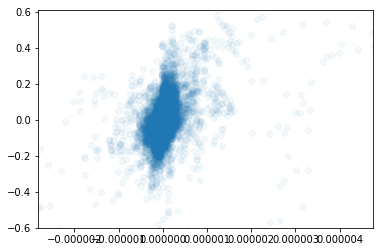

In [18]:
xcol = 'macd_tp'
hist = 12
f = plt.scatter(bars[xcol].iloc[24-hist:-hist].values, bars['24h_price_diff_pct'].iloc[24:].values, alpha=0.05)
ylim = plt.ylim([-0.6, bars['24h_price_diff_pct'].max()])
xlim = plt.xlim([bars[xcol].min(), bars[xcol].max()])

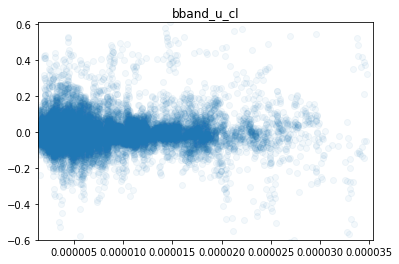

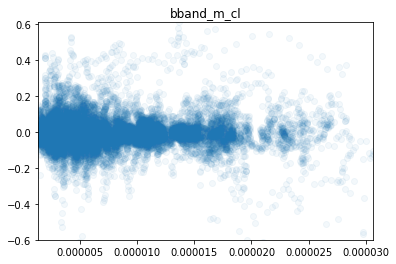

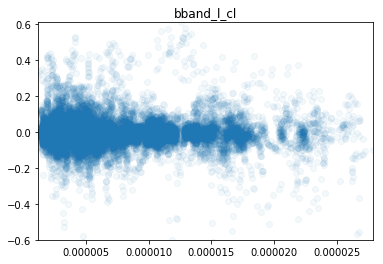

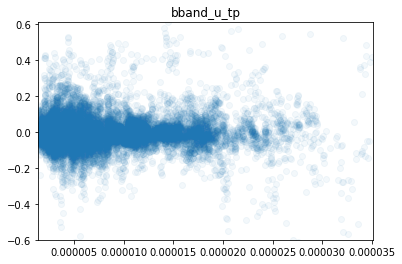

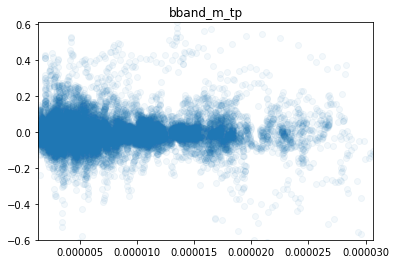

...

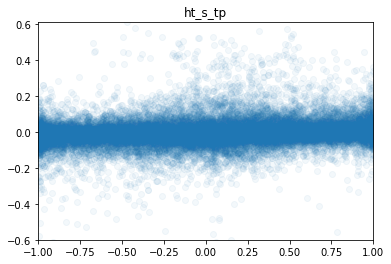

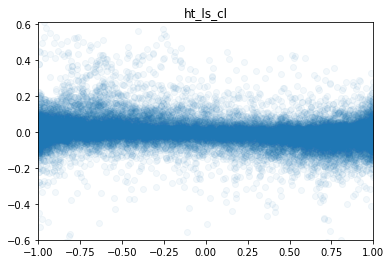

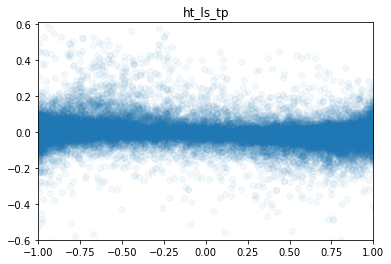

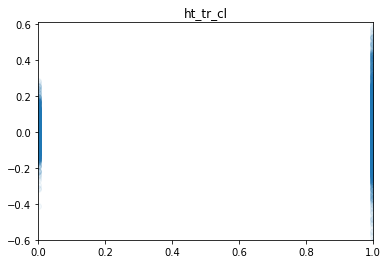

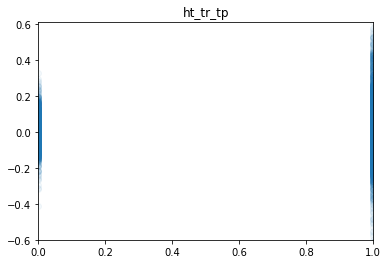

In [19]:
for i in indicators:
    xcol = i
    hist = 12
    f = plt.scatter(bars[xcol].iloc[24-hist:-hist].values, bars['24h_price_diff_pct'].iloc[24:].values, alpha=0.05)
    ylim = plt.ylim([-0.6, bars['24h_price_diff_pct'].max()])
    xlim = plt.xlim([bars[xcol].min(), bars[xcol].max()])
    plt.title(i)
    plt.show()

In [20]:
# indicators that look good for a linear model
lin_inds = ['bband_m_cl_diff',
            'bband_m_tp_diff',
            'dema_cl_diff',
            'dema_tp_diff',
            'ema_cl_diff',
            'ema_tp_diff',
            'kama_cl_diff',
            'kama_tp_diff',
            'ht_tl_cl_diff',
            'ht_tl_tp_diff',
            'kama_cl_diff',
            'kama_tp_diff',
            'midp_cl_diff',
            'midp_tp_diff',
            'midpr_diff',
            'sar_diff',
            'tema_cl_diff',
            'tema_tp_diff',
            'trima_cl_diff',
            'trima_tp_diff',
            'wma_cl_diff',
            'wma_tp_diff',
            'apo_cl',
            'apo_tp',
            'cci',
            'cmo_cl',
            'cmo_tp',
            'macdhist_cl',
            'macdhist_tp',
            'mom_cl',
            'mom_tp',
            'ppo_cl',
            'ppo_tp',
            'roc_cl',
            'roc_tp',
            'rocp_cl',
            'rocp_tp',
            'rocr_cl',
            'rocr_tp',
            'rocr_cl_100',
            'rocr_tp_100',
            'rsi_cl',
            'rsi_tp',
            'ht_ph_cl',
            'ht_ph_tp']

# nonlinear relationships, many highly nonlinear (bimodal, no obvious trend but might have interactions with others)
nonlin_inds = ['bband_u_cl',
                'bband_m_cl',
                'bband_l_cl',
                'bband_u_tp',
                'bband_m_tp',
                'bband_l_tp',
                'bband_u_cl_diff_hi',
                'bband_l_cl_diff_lo',
                'bband_u_tp_diff_hi',
                'bband_l_tp_diff_lo',
                'bband_u_cl_diff',
                'bband_l_cl_diff',
                'bband_u_tp_diff',
                'bband_l_tp_diff',
                'dema_cl',
                'dema_tp',
                'ema_cl',
                'ema_tp',
                'ht_tl_cl',
                'ht_tl_tp',
                'kama_cl',
                'kama_tp',
                'midp_cl',
                'midp_tp',
                'midpr',
                'sar',
                'tema_cl',
                'tema_tp',
                'trima_cl',
                'trima_tp',
                'wma_cl',
                'wma_tp',
                'adx',
                'adxr',
                'arup', # aroon
                'ardn',
                'aroonosc',
                'bop',
                'dx',
                'macd_cl',
                'macdsignal_cl',
                'macd_tp',
                'macdsignal_tp',
                'mfi',
                'mdi',
                'mdm',
                'pldi',
                'pldm',
                'slowk', # stochastic oscillator
                'slowd',
                'fastk',
                'fastd',
                'strsi_cl_k',
                'strsi_cl_d',
                'strsi_tp_k',
                'strsi_tp_d',
                'trix_cl',
                'trix_tp',
                'ultosc',
                'willr',
                'ad',
                'adosc',
                'obv_cl',
                'obv_tp',
                'atr',
                'natr',
                'trange',
                'ht_dcp_cl',
                'ht_dcp_tp',
                'ht_dcph_cl',
                'ht_dcph_tp',
                'ht_q_cl',
                'ht_q_tp',
                'ht_s_cl',
                'ht_s_tp',
                'ht_ls_cl',
                'ht_ls_tp',
                'ht_tr_cl',
                'ht_tr_tp'
             ]

In [21]:
latest_bars = bars.iloc[-1000:]

In [22]:
trace = Candlestick(latest_bars[['open', 'high', 'low', 'close']], x=latest_bars.index)
data = [trace, Scatter(x=latest_bars.index, y=latest_bars['sar'], mode='markers', name='parabolic SAR')]
iplot(data, filename='par_candles')

In [23]:
hist = 12
x_cols = lin_inds + ['mva_tp_24_diff', 'direction_volume']
X = sm.add_constant(bars[x_cols].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.537
Method:                 Least Squares   F-statistic:                     836.8
Date:                Sat, 21 Oct 2017   Prob (F-statistic):               0.00
Time:                        13:56:45   Log-Likelihood:             3.4321e+05
No. Observations:               26699   AIC:                        -6.863e+05
Df Residuals:                   26661   BIC:                        -6.860e+05
Df Model:                          37                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0001   1.46e-05      8.188      0.000    9.09e-05       0.000
x1            -5.6049      0.620     -9.035      0.000      -6.821      -4.389
x2            14.0729      0.652     21.569      0.000      12.794      15.352
x3            -7.8122      1.655     -4.720      0.000     -11.057      -4.568
x4             9.2450      1.650      5.602      0.000       6.010      12.480
x5           -20.4185      2.238     -9.125      0.000     -24.805     -16.032
x6            17.3587      2.241      7.744      0.000      12.965      21.752
x7             0.1104      0.030      3.648      0.000       0.051       0.170
x8            -0.1265      0.033     -3.831      0.000      -0.191      -0.062
x9             0.7293      0.131      5.548      0.000       0.472       0.987
x10           -1.3376      0.145     -9.197      0.000      -1.623      -1.053
x11            0.1104      0.030      3.648      0.000       0.051       0.170
x12           -0.1265      0.033     -3.831      0.000      -0.191      -0.062
x13           -0.0605      0.076     -0.799      0.424      -0.209       0.088
x14           -0.1826      0.098     -1.862      0.063      -0.375       0.010
x15            0.1999      0.031      6.421      0.000       0.139       0.261
x16           -0.0341      0.008     -4.084      0.000      -0.050      -0.018
x17           -1.5954      0.352     -4.528      0.000      -2.286      -0.905
x18            2.2811      0.406      5.615      0.000       1.485       3.077
x19           -5.5536      1.997     -2.782      0.005      -9.467      -1.640
x20           25.0614      2.154     11.637      0.000      20.840      29.282
x21           40.0560      5.181      7.731      0.000      29.901      50.211
x22          -66.5266      5.349    -12.437      0.000     -77.011     -56.042
x23         3.197e-06   6.66e-07      4.797      0.000    1.89e-06     4.5e-06
x24         9.907e-07   7.35e-07      1.347      0.178    -4.5e-07    2.43e-06
x25         2.049e-10   7.33e-11      2.795      0.005    6.12e-11    3.49e-10
x26         4.319e-05   5.53e-06      7.811      0.000    3.23e-05     5.4e-05
x27         3.227e-05   3.79e-06      8.521      0.000    2.48e-05    3.97e-05
x28           13.7515      1.883      7.302      0.000      10.060      17.443
x29            7.5998      1.946      3.905      0.000       3.785      11.415
x30           -0.0853      0.044     -1.939      0.053      -0.171       0.001
x31           -0.0263      0.048     -0.544      0.587      -0.121       0.068
x32         1.564e-07   4.19e-08      3.738      0.000    7.44e-08    2.38e-07
x33        -9.113e-08   4.13e-08     -2.208      0.027   -1.72e-07   -1.03e-08
x34        -5.071e-05   6.32e-06     -8.025      0.000   -6.31e-05   -3.83e-05
x35        -2.357e-05   2.85e-06     -8.260      0.000   -2.92e-05    -1.8e-05
x3

In [24]:
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit_regularized(method='elastic_net', alpha=1e-10, L1_wt=1.0)
fit.params

array([  8.70406585e-08,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   2.18327656e-06,
        -1.35415906e-06,   6.04333372e-10,  -3.29303536e-09,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   9.50847036e-08,
        -8.19985747e-08,   2.29270589e-08,   5.10188000e-08,
        -3.10546660e-06,   1.30236631e-06,  -7.56661561e-09,
         3.76159346e-09,   0.00000000e+00,   0.00000000e+00,
        -7.73882098e-10,  -1.03132213e-09,   0.00000000e+00,
         3.92530987e-07,   0.00000000e+00,   2.40410240e-09])

In [25]:
np.where(fit.params[1:] != 0)[0]

array([22, 23, 24, 25, 31, 32, 33, 34, 35, 36, 37, 38, 41, 42, 44, 46])

In [26]:
x_col_np = np.array(x_cols)

In [27]:
x_col_np[np.where(fit.params[1:] != 0)[0]]

array(['apo_cl', 'apo_tp', 'cci', 'cmo_cl', 'ppo_cl', 'ppo_tp', 'roc_cl',
       'roc_tp', 'rocp_cl', 'rocp_tp', 'rocr_cl', 'rocr_tp', 'rsi_cl',
       'rsi_tp', 'ht_ph_tp', 'direction_volume'],
      dtype='<U16')

In [28]:
np.where(fit.params != 0)[0]

array([ 0, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 42, 43, 45, 47])

In [29]:
hist = 12
x_cols = lin_inds + ['mva_tp_24_diff', 'direction_volume']
X = sm.add_constant(bars[x_cols].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.537
Method:                 Least Squares   F-statistic:                     836.8
Date:                Sat, 21 Oct 2017   Prob (F-statistic):               0.00
Time:                        13:57:46   Log-Likelihood:             3.4321e+05
No. Observations:               26699   AIC:                        -6.863e+05
Df Residuals:                   26661   BIC:                        -6.860e+05
Df Model:                          37                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0001   1.46e-05      8.188      0.000    9.09e-05       0.000
x1            -5.6049      0.620     -9.035      0.000      -6.821      -4.389
x2            14.0729      0.652     21.569      0.000      12.794      15.352
x3            -7.8122      1.655     -4.720      0.000     -11.057      -4.568
x4             9.2450      1.650      5.602      0.000       6.010      12.480
x5           -20.4185      2.238     -9.125      0.000     -24.805     -16.032
x6            17.3587      2.241      7.744      0.000      12.965      21.752
x7             0.1104      0.030      3.648      0.000       0.051       0.170
x8            -0.1265      0.033     -3.831      0.000      -0.191      -0.062
x9             0.7293      0.131      5.548      0.000       0.472       0.987
x10           -1.3376      0.145     -9.197      0.000      -1.623      -1.053
x11            0.1104      0.030      3.648      0.000       0.051       0.170
x12           -0.1265      0.033     -3.831      0.000      -0.191      -0.062
x13           -0.0605      0.076     -0.799      0.424      -0.209       0.088
x14           -0.1826      0.098     -1.862      0.063      -0.375       0.010
x15            0.1999      0.031      6.421      0.000       0.139       0.261
x16           -0.0341      0.008     -4.084      0.000      -0.050      -0.018
x17           -1.5954      0.352     -4.528      0.000      -2.286      -0.905
x18            2.2811      0.406      5.615      0.000       1.485       3.077
x19           -5.5536      1.997     -2.782      0.005      -9.467      -1.640
x20           25.0614      2.154     11.637      0.000      20.840      29.282
x21           40.0560      5.181      7.731      0.000      29.901      50.211
x22          -66.5266      5.349    -12.437      0.000     -77.011     -56.042
x23         3.197e-06   6.66e-07      4.797      0.000    1.89e-06     4.5e-06
x24         9.907e-07   7.35e-07      1.347      0.178    -4.5e-07    2.43e-06
x25         2.049e-10   7.33e-11      2.795      0.005    6.12e-11    3.49e-10
x26         4.319e-05   5.53e-06      7.811      0.000    3.23e-05     5.4e-05
x27         3.227e-05   3.79e-06      8.521      0.000    2.48e-05    3.97e-05
x28           13.7515      1.883      7.302      0.000      10.060      17.443
x29            7.5998      1.946      3.905      0.000       3.785      11.415
x30           -0.0853      0.044     -1.939      0.053      -0.171       0.001
x31           -0.0263      0.048     -0.544      0.587      -0.121       0.068
x32         1.564e-07   4.19e-08      3.738      0.000    7.44e-08    2.38e-07
x33        -9.113e-08   4.13e-08     -2.208      0.027   -1.72e-07   -1.03e-08
x34        -5.071e-05   6.32e-06     -8.025      0.000   -6.31e-05   -3.83e-05
x35        -2.357e-05   2.85e-06     -8.260      0.000   -2.92e-05    -1.8e-05
x3

In [30]:
np.where(fit.pvalues < 0.05)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 15, 16, 17, 18,
        19, 20, 21, 22, 23, 25, 26, 27, 28, 29, 32, 33, 34, 35, 36, 37, 38,
        39, 40, 41, 42, 43, 44, 46, 47]),)

In [31]:
# start at first pval because intercept is 0th index
sig_x_1 = x_col_np[np.where(fit.pvalues[1:] < 0.05)]

In [32]:
sig_x_1

array(['bband_m_cl_diff', 'bband_m_tp_diff', 'dema_cl_diff',
       'dema_tp_diff', 'ema_cl_diff', 'ema_tp_diff', 'kama_cl_diff',
       'kama_tp_diff', 'ht_tl_cl_diff', 'ht_tl_tp_diff', 'kama_cl_diff',
       'kama_tp_diff', 'midpr_diff', 'sar_diff', 'tema_cl_diff',
       'tema_tp_diff', 'trima_cl_diff', 'trima_tp_diff', 'wma_cl_diff',
       'wma_tp_diff', 'apo_cl', 'cci', 'cmo_cl', 'cmo_tp', 'macdhist_cl',
       'macdhist_tp', 'ppo_cl', 'ppo_tp', 'roc_cl', 'roc_tp', 'rocp_cl',
       'rocp_tp', 'rocr_cl', 'rocr_tp', 'rocr_cl_100', 'rocr_tp_100',
       'rsi_cl', 'rsi_tp', 'ht_ph_cl', 'mva_tp_24_diff', 'direction_volume'],
      dtype='<U16')

In [33]:
hist = 12
X = sm.add_constant(bars[sig_x_1].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.536
Method:                 Least Squares   F-statistic:                     996.1
Date:                Sat, 21 Oct 2017   Prob (F-statistic):               0.00
Time:                        13:58:07   Log-Likelihood:             3.4318e+05
No. Observations:               26699   AIC:                        -6.863e+05
Df Residuals:                   26667   BIC:                        -6.860e+05
Df Model:                          31                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0001   1.58e-05     -7.568      0.000      -0.000   -8.85e-05
x1            -5.0398      0.566     -8.907      0.000      -6.149      -3.931
x2            13.2550      0.585     22.653      0.000      12.108      14.402
x3            -8.0296      1.616     -4.970      0.000     -11.197      -4.863
x4             9.6102      1.609      5.973      0.000       6.456      12.764
x5           -20.2597      2.207     -9.179      0.000     -24.586     -15.933
x6            17.6534      2.200      8.024      0.000      13.341      21.966
x7             0.1197      0.030      3.962      0.000       0.060       0.179
x8            -0.1389      0.033     -4.222      0.000      -0.203      -0.074
x9             0.7236      0.130      5.552      0.000       0.468       0.979
x10           -1.3471      0.144     -9.324      0.000      -1.630      -1.064
x11            0.1197      0.030      3.962      0.000       0.060       0.179
x12           -0.1389      0.033     -4.222      0.000      -0.203      -0.074
x13            0.1236      0.023      5.337      0.000       0.078       0.169
x14           -0.0274      0.008     -3.379      0.001      -0.043      -0.012
x15           -1.5383      0.351     -4.378      0.000      -2.227      -0.850
x16            2.3743      0.403      5.889      0.000       1.584       3.165
x17           -3.2837      1.707     -1.924      0.054      -6.629       0.061
x18           22.6909      1.675     13.547      0.000      19.408      25.974
x19           37.2934      5.057      7.375      0.000      27.382      47.205
x20          -64.1868      5.147    -12.471      0.000     -74.275     -54.098
x21          4.02e-06   2.72e-07     14.796      0.000    3.49e-06    4.55e-06
x22         2.156e-10    7.3e-11      2.953      0.003    7.25e-11    3.59e-10
x23        -7.429e-06   4.87e-07    -15.268      0.000   -8.38e-06   -6.48e-06
x24         3.283e-06    4.9e-07      6.697      0.000    2.32e-06    4.24e-06
x25           15.6476      1.659      9.433      0.000      12.396      18.899
x26            5.0314      1.524      3.302      0.001       2.045       8.018
x27         1.442e-07   3.82e-08      3.775      0.000    6.93e-08    2.19e-07
x28        -8.097e-08   3.76e-08     -2.155      0.031   -1.55e-07   -7.33e-09
x29        -1.005e-05   1.35e-06     -7.458      0.000   -1.27e-05   -7.41e-06
x30         1.298e-05   1.14e-06     11.386      0.000    1.07e-05    1.52e-05
x31         6.559e-07   6.19e-08     10.590      0.000    5.35e-07    7.77e-07
x32         2.517e-07   2.14e-08     11.786      0.000     2.1e-07    2.94e-07
x33         7.573e-07   7.12e-08     10.642      0.000    6.18e-07    8.97e-07
x34         5.312e-07   4.45e-08     11.947      0.000    4.44e-07    6.18e-07
x35         1.006e-05   1.35e-06      7.466      0.000    7.42e-06    1.27e-05
x3

In [34]:
# start at first pval because intercept is 0th index
sig_x_2 = sig_x_1[np.where(fit.pvalues[1:] < 0.05)]

In [35]:
hist = 12
X = sm.add_constant(bars[sig_x_2].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.536
Method:                 Least Squares   F-statistic:                     1029.
Date:                Sat, 21 Oct 2017   Prob (F-statistic):               0.00
Time:                        13:58:26   Log-Likelihood:             3.4318e+05
No. Observations:               26699   AIC:                        -6.863e+05
Df Residuals:                   26668   BIC:                        -6.860e+05
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0002   1.01e-05    -18.280      0.000      -0.000      -0.000
x1            -4.4223      0.466     -9.490      0.000      -5.336      -3.509
x2            12.6669      0.499     25.387      0.000      11.689      13.645
x3            -6.0594      1.250     -4.848      0.000      -8.509      -3.610
x4             7.6419      1.242      6.153      0.000       5.207      10.076
x5           -18.2695      1.950     -9.369      0.000     -22.091     -14.448
x6            15.4907      1.891      8.190      0.000      11.784      19.198
x7             0.1214      0.030      4.020      0.000       0.062       0.181
x8            -0.1417      0.033     -4.312      0.000      -0.206      -0.077
x9             0.6818      0.129      5.306      0.000       0.430       0.934
x10           -1.2998      0.142     -9.129      0.000      -1.579      -1.021
x11            0.1214      0.030      4.020      0.000       0.062       0.181
x12           -0.1417      0.033     -4.312      0.000      -0.206      -0.077
x13            0.1121      0.022      5.011      0.000       0.068       0.156
x14           -0.0268      0.008     -3.307      0.001      -0.043      -0.011
x15           -1.3034      0.330     -3.956      0.000      -1.949      -0.658
x16            2.0943      0.376      5.569      0.000       1.357       2.831
x17           19.6860      0.605     32.515      0.000      18.499      20.873
x18           29.2382      2.836     10.309      0.000      23.679      34.798
x19          -56.1979      3.042    -18.474      0.000     -62.160     -50.236
x20         4.189e-06   2.57e-07     16.286      0.000    3.68e-06    4.69e-06
x21         2.149e-10    7.3e-11      2.943      0.003    7.18e-11    3.58e-10
x22        -1.133e-05   7.37e-07    -15.380      0.000   -1.28e-05   -9.89e-06
x23        -7.679e-07   1.48e-07     -5.195      0.000   -1.06e-06   -4.78e-07
x24           16.1237      1.640      9.829      0.000      12.908      19.339
x25            5.0939      1.524      3.343      0.001       2.108       8.080
x26         1.627e-07    3.7e-08      4.401      0.000    9.02e-08    2.35e-07
x27        -9.941e-08   3.63e-08     -2.737      0.006   -1.71e-07   -2.82e-08
x28         1.401e-07   2.19e-07      0.641      0.522   -2.88e-07    5.69e-07
x29          1.01e-05   6.69e-07     15.102      0.000    8.79e-06    1.14e-05
x30         1.061e-07   5.88e-09     18.050      0.000    9.46e-08    1.18e-07
x31          2.46e-07   2.29e-08     10.747      0.000    2.01e-07    2.91e-07
x32         1.271e-07   6.96e-09     18.271      0.000    1.13e-07    1.41e-07
x33         3.736e-07   2.83e-08     13.179      0.000    3.18e-07    4.29e-07
x34        -1.223e-07   2.18e-07     -0.560      0.575    -5.5e-07    3.06e-07
x35        -1.014e-05   6.69e-07    -15.145      0.000   -1.14e-05   -8.83e-06
x3

In [36]:
# start at first pval because intercept is 0th index
sig_x_3 = sig_x_2[np.where(fit.pvalues[1:] < 0.05)]

In [37]:
hist = 12
X = sm.add_constant(bars[sig_x_3].iloc[24 - hist:-hist].values)
y = bars['24h_price_diff'].iloc[24:].values
model = sm.OLS(y[:-1000], X[:-1000])
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.536
Method:                 Least Squares   F-statistic:                     1029.
Date:                Sat, 21 Oct 2017   Prob (F-statistic):               0.00
Time:                        13:58:36   Log-Likelihood:             3.4318e+05
No. Observations:               26699   AIC:                        -6.863e+05
Df Residuals:                   26668   BIC:                        -6.860e+05
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0001   7.68e-06     17.863      0.000       0.000       0.000
x1            -4.4223      0.466     -9.490      0.000      -5.336      -3.509
x2            12.6669      0.499     25.387      0.000      11.689      13.645
x3            -6.0594      1.250     -4.848      0.000      -8.509      -3.610
x4             7.6419      1.242      6.153      0.000       5.207      10.076
x5           -18.2695      1.950     -9.369      0.000     -22.091     -14.448
x6            15.4907      1.891      8.190      0.000      11.784      19.198
x7             0.1214      0.030      4.020      0.000       0.062       0.181
x8            -0.1417      0.033     -4.312      0.000      -0.206      -0.077
x9             0.6818      0.129      5.306      0.000       0.430       0.934
x10           -1.2998      0.142     -9.129      0.000      -1.579      -1.021
x11            0.1214      0.030      4.020      0.000       0.062       0.181
x12           -0.1417      0.033     -4.312      0.000      -0.206      -0.077
x13            0.1121      0.022      5.011      0.000       0.068       0.156
x14           -0.0268      0.008     -3.308      0.001      -0.043      -0.011
x15           -1.3034      0.330     -3.956      0.000      -1.949      -0.658
x16            2.0943      0.376      5.569      0.000       1.357       2.831
x17           19.6860      0.605     32.515      0.000      18.499      20.873
x18           29.2382      2.836     10.309      0.000      23.679      34.798
x19          -56.1979      3.042    -18.474      0.000     -62.160     -50.236
x20         4.189e-06   2.57e-07     16.286      0.000    3.68e-06    4.69e-06
x21         2.149e-10    7.3e-11      2.943      0.003    7.18e-11    3.58e-10
x22        -1.927e-05   1.09e-06    -17.630      0.000   -2.14e-05   -1.71e-05
x23        -2.667e-06   1.16e-07    -23.004      0.000   -2.89e-06   -2.44e-06
x24           16.1237      1.640      9.829      0.000      12.908      19.339
x25            5.0939      1.524      3.343      0.001       2.108       8.080
x26         1.627e-07    3.7e-08      4.401      0.000    9.02e-08    2.35e-07
x27        -9.941e-08   3.63e-08     -2.737      0.006   -1.71e-07   -2.82e-08
x28         2.328e-05   1.24e-06     18.853      0.000    2.09e-05    2.57e-05
x29         9.988e-07   2.33e-07      4.287      0.000    5.42e-07    1.46e-06
x30         2.128e-07   9.73e-09     21.877      0.000    1.94e-07    2.32e-07
x31          1.01e-06   2.32e-07      4.346      0.000    5.55e-07    1.47e-06
x32         5.757e-07   3.47e-08     16.603      0.000    5.08e-07    6.44e-07
x33        -2.332e-05   1.24e-06    -18.876      0.000   -2.57e-05   -2.09e-05
x34         3.853e-05   2.19e-06     17.629      0.000    3.43e-05    4.28e-05
x35         5.335e-06   2.32e-07     23.001      0.000    4.88e-06    5.79e-06
x3

In [39]:
hist = 12
not_converged = True
cur_x_cols = np.array(lin_inds + ['mva_tp_24_diff', 'direction_volume'])
iterations = 0
while not_converged:
    iterations += 1
    print(iterations)
    X = sm.add_constant(bars[cur_x_cols].iloc[24 - hist:-hist].values)
    y = bars['24h_price_diff_pct'].iloc[24:].values
    model = sm.OLS(y[:-1000], X[:-1000])
    fit = model.fit()
    if len(np.where(fit.pvalues[1:] > 0.05)[0]) != 0:
        print('dropping columns:', cur_x_cols[np.where(fit.pvalues[1:] > 0.05)[0]])
        print('with p-values:', fit.pvalues[1:][np.where(fit.pvalues[1:] > 0.05)[0]])
        cur_x_cols = cur_x_cols[np.where(fit.pvalues[1:] < 0.05)[0]]
    else:
        not_converged = False

1
dropping columns: ['ht_tl_cl_diff' 'ht_tl_tp_diff' 'tema_cl_diff' 'tema_tp_diff'
 'trima_cl_diff' 'apo_cl' 'mom_cl' 'mom_tp' 'ht_ph_tp']
with p-values: [ 0.15228233  0.18773249  0.76879253  0.59287764  0.69406978  0.30547651
  0.0642864   0.95757753  0.08995649]
2


In [40]:
past_preds = fit.predict(X[:-1000])

In [41]:
data = [Scatter(x=past_preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [51]:
preds = fit.predict(X[-1000:])
data = [Scatter(x=preds, y=y[-1000:], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [42]:
conf = fit.conf_int(0.05)  # 95% confidence intervals

In [46]:
preds = np.dot(X[:-1000], conf[:, 0])
data = [Scatter(x=preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual, lower 99% conf interval',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [47]:
preds = np.dot(X[:-1000], conf[:, 1])
data = [Scatter(x=preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual, upper 95% conf interval',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [120]:
model = sm.OLS(y[:-1000], X[:-1000])
fit_reg = model.fit_regularized(method='elastic_net', alpha=1e-10, L1_wt=1.0)
fit_reg.params

array([ -5.11665102e-03,   9.06744409e+02,   3.37584604e+01,
         3.92629508e+01,   0.00000000e+00,   0.00000000e+00,
        -6.36125883e+01,  -6.88427127e+01,   0.00000000e+00,
        -4.68862013e+01,   0.00000000e+00,  -8.00713564e+01,
        -9.66438694e+01,  -5.48376752e+02,   0.00000000e+00,
         4.11596630e+02,  -9.92636019e+01,  -2.52645873e+01,
         1.75763882e+02,  -2.26206293e-04,   7.25319159e-02,
        -3.10691008e-02,  -1.20239785e-04,   4.03822856e-05,
         2.64945903e-05,  -1.15644855e-03,   3.85470516e-05,
        -1.77525605e-04,   2.51021496e-04,   0.00000000e+00,
        -5.60753710e+04,   2.71508930e+04,  -3.99880334e+04,
         1.71331618e-04,  -1.45148594e-02,   6.17885653e-04,
         5.41271678e-03,   5.09743411e-03,   0.00000000e+00,
         1.34296622e-02,   4.71884008e-03,  -4.71678401e-05,
        -1.42500279e-04,   1.47747931e-05,   1.58480656e-03,
         5.10847345e-04,  -4.36518739e-05,   3.81767322e-06,
        -4.20112701e-04,

In [126]:
preds = fit_reg.predict(X[:-1000])
data = [Scatter(x=preds, y=y[:-1000], mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [129]:
X_fit = sm.add_constant(preds)
y_fit = y[:-1000]
model = sm.OLS(y_fit, X_fit)
fit_fit = model.fit()
fit_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.510
Model:                            OLS   Adj. R-squared:                  0.510
Method:                 Least Squares   F-statistic:                 1.839e+04
Date:                Thu, 19 Oct 2017   Prob (F-statistic):               0.00
Time:                        11:44:05   Log-Likelihood:                 21024.
No. Observations:               17665   AIC:                        -4.204e+04
Df Residuals:                   17663   BIC:                        -4.203e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -1.999e-05      0.001     -0.036      0.971      -0.001       0.001
x1             1.0067      0.007    135.600      0.000       0.992       1.021
==============================================================================
Omnibus:                     5429.456   Durbin-Watson:                   0.295
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           459229.137
Skew:                          -0.532   Prob(JB):                         0.00
Kurtosis:                      27.956   Cond. No.                         13.4
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [132]:
fit_fit.params

array([ -1.99892233e-05,   1.00667680e+00])

In [150]:
x_line = np.linspace(min(preds), max(preds), 100)
y_line = fit_fit.params[1]*x_line + fit_fit.params[0]

In [151]:
x_line

array([-1.28748339, -1.26456541, -1.24164742, -1.21872943, -1.19581144,
       -1.17289345, -1.14997546, -1.12705747, -1.10413949, -1.0812215 ,
       -1.05830351, -1.03538552, -1.01246753, -0.98954954, -0.96663156,
       -0.94371357, -0.92079558, -0.89787759, -0.8749596 , -0.85204161,
       -0.82912362, -0.80620564, -0.78328765, -0.76036966, -0.73745167,
       -0.71453368, -0.69161569, -0.66869771, -0.64577972, -0.62286173,
       -0.59994374, -0.57702575, -0.55410776, -0.53118978, -0.50827179,
       -0.4853538 , -0.46243581, -0.43951782, -0.41659983, -0.39368184,
       -0.37076386, -0.34784587, -0.32492788, -0.30200989, -0.2790919 ,
       -0.25617391, -0.23325593, -0.21033794, -0.18741995, -0.16450196,
       -0.14158397, -0.11866598, -0.09574799, -0.07283001, -0.04991202,
       -0.02699403, -0.00407604,  0.01884195,  0.04175994,  0.06467792,
        0.08759591,  0.1105139 ,  0.13343189,  0.15634988,  0.17926787,
        0.20218586,  0.22510384,  0.24802183,  0.27093982,  0.29

In [160]:
conf = fit_fit.conf_int(0.05)

In [155]:
preds_fit = fit_fit.predict(X_fit)
preds_min = conf[0, 0] + conf[1, 0] * x_line
preds_max = conf[0, 1] + conf[1, 1] * x_line
data = [Scatter(x=preds, y=y_fit, mode='markers', name='preds vs actual'),
       Scatter(x=x_line, y=y_line, mode='lines', name='fit'),
       Scatter(x=x_line, y=preds_min, mode='lines', name='fit min'),
       Scatter(x=x_line, y=preds_max, mode='lines', name='fit max')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='par_candles')

In [153]:
fit_fit.conf_int(0.05)

array([[-0.00110633,  0.00106635],
       [ 0.99212524,  1.02122836]])

In [156]:
fit_fit.params

array([ -1.99892233e-05,   1.00667680e+00])

In [161]:
conf

array([[-0.00110633,  0.00106635],
       [ 0.99212524,  1.02122836]])

In [164]:
conf[1, 1]

1.0212283632083226